###**Installation package**

In [ ]:
!pip install fuzzywuzzy
!pip install python-Levenshtein

###**Dash**

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import pickle as pkl

In [ ]:
import re
from fuzzywuzzy import fuzz
from fuzzywuzzy import process

###**Importation du dataset**

In [ ]:
import pandas as pd
df = pd.read_csv("/content/data_cap.csv",  index_col=[0])

###**Rename Dataset**

In [ ]:
df.rename(columns= {"Intervenants réel": "Intervenants_reel", "Matière" : "Matiere", "Type d'intervention": "Type_d'intervention"}, inplace = True)

###**Observations des 5 premières lignes**

In [ ]:
df.head(5).style.background_gradient(axis=0)

,Intervenants,Intervenants_reel,Matiere,Campus,Year,Month,Week,Total hours,Date,Type_d'intervention,Referencie
0,Intervenant_1,Intervenant_1,cours_b2_économie générale,IA_School_Paris,2022.000000,2.000000,5.000000,3.500000,3.000000,Cours_fr,Innovation
1,Intervenant_5,Intervenant_5,ctp_langages et compilation,EFREI,2022.000000,2.000000,5.000000,3.000000,1.000000,CTP_fr,Caplogy
2,Intervenant_5,Intervenant_5,prj_l1_projet transverse,EFREI,2022.000000,2.000000,5.000000,2.000000,1.000000,PRJ_fr,Caplogy
3,Intervenant_5,Intervenant_5,ctp_en_operating systems,EFREI,2022.000000,2.000000,5.000000,2.000000,1.000000,CTP_en,Caplogy
4,Intervenant_5,Intervenant_5,td_en_advanced machine learning,ESILV,2022.000000,2.000000,5.000000,3.000000,2.000000,TD_en,Caplogy


###***Informations Première***

**1) Noms des colonnes**

In [ ]:
df.columns

Index(['Intervenants', 'Intervenants_reel', 'Matiere', 'Campus', 'Year',
       'Month', 'Week', 'Total hours', 'Date', 'Type_d'intervention',
       'Referencie'],
      dtype='object')

**2) Nombre de variables quantitatives et catégorielles**

In [ ]:
print("============== Total Nature des variables ==============")
pd.value_counts(df.dtypes)

============== Total Nature des variables ==============


object     6
float64    5
dtype: int64

**3) Informations sur la nature des colonnes de chaque colonne**

In [ ]:
print("================TYpes data ===========================")
df.dtypes

================TYpes data ===========================


Intervenants            object
Intervenants_reel       object
Matiere                 object
Campus                  object
Year                   float64
Month                  float64
Week                   float64
Total hours            float64
Date                   float64
Type_d'intervention     object
Referencie              object
dtype: object

**4) Informations globales du datset**

In [ ]:
print("================info data ===========================")
df.info()

================info data ===========================
<class 'pandas.core.frame.DataFrame'>
Int64Index: 2732 entries, 0 to 2790
Data columns (total 11 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Intervenants         2732 non-null   object 
 1   Intervenants_reel    2732 non-null   object 
 2   Matiere              2732 non-null   object 
 3   Campus               2732 non-null   object 
 4   Year                 2732 non-null   float64
 5   Month                2732 non-null   float64
 6   Week                 2732 non-null   float64
 7   Total hours          2732 non-null   float64
 8   Date                 2732 non-null   float64
 9   Type_d'intervention  2732 non-null   object 
 10  Referencie           2732 non-null   object 
dtypes: float64(5), object(6)
memory usage: 256.1+ KB


**5) Dimension du dataset**

In [ ]:
print("================ Dimension du dataset ================")
df.shape

================ Dimension du dataset ================


(2732, 11)

**6) Observation des cardinalités en pourcentage**

In [ ]:
print("===================Cardinalité =========================")
nunique= df.nunique().sort_values().to_frame("unique_values")
nunique

===================Cardinalité =========================


,unique_values
Year,1
Referencie,4
Month,7
Total hours,20
Campus,27
Week,28
Intervenants,31
Date,31
Intervenants_reel,40
Type_d'intervention,43


In [ ]:
from google.colab import output
output.disable_custom_widget_manager()

###**Traitement des valeurs manquantes, doublons & valeurs nulles**

**1) doublons**

In [ ]:
print("=============== Nombre Total de doublons ===============")
n_duplicates= df.duplicated().sum()
n_duplicates

=============== Nombre Total de doublons ===============


564

In [ ]:
print("=============== Nombre total de doublons ===============")
df.drop_duplicates(inplace = True)
df.duplicated().sum()

=============== Nombre total de doublons ===============


0

In [ ]:
print("================ Nouvelle Dimension du dataset ================")
df.shape

================ Nouvelle Dimension du dataset ================


(2168, 11)

###**Valeurs manquantes**

In [ ]:
def missing_value(df):
  d1 = df.isna().sum().to_frame()
  d2 = (df.isna().sum() / df.shape[0]).to_frame()
  d3 = df.dtypes.to_frame()
  df_missing = pd.concat([d1,d2,d3],axis = 1)
  df_missing.columns = ['missing value','% of missing value','dtypes']
  print('='*100)
  if (df_missing.iloc[:,0].any() !=0):
      print("Notre dataframe comporte " + str(df.shape[1]) +
      " colonnes. Et il y a " + str(df_missing.shape[0]) + " colonnes qui ont des valeurs manquantes.")
  else:
      print("Notre dataframe comporte " + str(df.shape[1]) +
      " colonnes. Et il n'y a aucune colonne qui à des valeurs manquantes.")
  print('-'*100)
  print(df_missing)

In [ ]:
missing_value(df)

Notre dataframe comporte 11 colonnes. Et il n'y a aucune colonne qui à des valeurs manquantes.
----------------------------------------------------------------------------------------------------
                     missing value  % of missing value   dtypes
Intervenants                     0                 0.0   object
Intervenants_reel                0                 0.0   object
Matiere                          0                 0.0   object
Campus                           0                 0.0   object
Year                             0                 0.0  float64
Month                            0                 0.0  float64
Week                             0                 0.0  float64
Total hours                      0                 0.0  float64
Date                             0                 0.0  float64
Type_d'intervention              0                 0.0   object
Referencie                       0                 0.0   object


**Valeurs nulles**

In [ ]:
def null_value(df):
  d1 = df.isnull().sum().to_frame()
  d2 = (df.isnull().sum() / df.shape[0]).to_frame()
  d3 = df.dtypes.to_frame()
  df_null = pd.concat([d1,d2,d3],axis = 1)
  df_null.columns = ['null value','% of null value','dtypes']
  print('='*100)
  if (df_null.iloc[:,0].any() !=0):
      print("Notre dataframe comporte " + str(df.shape[1]) +
      " colonnes. Et il y a " + str(df_null.shape[0]) + " colonnes qui ont des valeurs null.")
  else:
      print("Notre dataframe comporte " + str(df.shape[1]) +
      " colonnes. Et il n'y a aucune colonne qui à des valeurs null.")
  print('-'*100)
  print(df_null)

In [ ]:
null_value(df)

Notre dataframe comporte 11 colonnes. Et il n'y a aucune colonne qui à des valeurs null.
----------------------------------------------------------------------------------------------------
                     null value  % of null value   dtypes
Intervenants                  0              0.0   object
Intervenants_reel             0              0.0   object
Matiere                       0              0.0   object
Campus                        0              0.0   object
Year                          0              0.0  float64
Month                         0              0.0  float64
Week                          0              0.0  float64
Total hours                   0              0.0  float64
Date                          0              0.0  float64
Type_d'intervention           0              0.0   object
Referencie                    0              0.0   object


###**Traitement de texte: Intervenants reel**

In [ ]:
df["Intervenants_reel"].replace("Remplacement Arrêt Maladie", "Remplacement Arrêt maladie", inplace = True)

In [ ]:
df[df["Intervenants_reel"] == "<span><span>ANNE Sophie</span></span>"]

,Intervenants,Intervenants_reel,Matiere,Campus,Year,Month,Week,Total hours,Date,Type_d'intervention,Referencie
95,Intervenant_19,<span><span>ANNE Sophie</span></span>,seance_b3_cra,ESCOM,2022.0,4.0,15.0,1.5,15.0,Seance_fr,Innovation


In [ ]:
df[df["Intervenants_reel"] == "<span>ANNE Sophie</span>"]

,Intervenants,Intervenants_reel,Matiere,Campus,Year,Month,Week,Total hours,Date,Type_d'intervention,Referencie
94,Intervenant_19,<span>ANNE Sophie</span>,seance_b3_cra,ESCOM,2022.0,4.0,15.0,1.5,15.0,Seance_fr,Innovation


In [ ]:
df["Intervenants_reel"].replace("<span>ANNE Sophie</span>", "ANNE Sophie", inplace = True)
df["Intervenants_reel"].replace("<span><span>ANNE Sophie</span></span>", "ANNE Sophie", inplace = True)

###**Traitement de texte: Matiere**

In [ ]:
matiere_unique=list(df["Matiere"].unique())

def sentence_fuzzy(sentence,matiere_unique,ratio=95):
    to_return=[]

    for x in matiere_unique :
        if fuzz.ratio(x,sentence) >ratio :
            #print(x)
            to_return.append(x)
    return to_return

In [ ]:
from fuzzywuzzy import fuzz

for s in matiere_unique :
    if s in df["Matiere"].unique():
        df['Matiere'] = df['Matiere'].replace(sentence_fuzzy(s,matiere_unique,50),s)
    else  :
        print(s)

tp_algorithmique et structures de données 1 
td_en_computer vision
seance_b2_integral avance
seance_na_fondement mathematique
seance_na_statistiques
cours_b28_commerce international
cours_m2_soutenances
cours_3a_cra
seance_m2_soutenances ia school
seance_masterclass_machine learning
seance_b3_cra
prj_na_introdution projet
seance_na_soutenance
seance_m1_specialité
tp_na_algorithmique et structures de données 1
seance_bts_réseau
tp_int2_en_introduction to databases
cours_bach_spécialité
tp_en_introduction to git
ctp_entreprise resource planning
tp_en_web programming
tp_introduction à git
prj_en_web programming
prj_programmation web
cours_m1_soutenance_visio
cours_m1_maths et optimisation
cours_b1_physique
cours_3a_statistique
cours_b3_diagonalisation
cours_b3_regression
seance_b3_diagonalisation
seance_m1_regression
seance_b1_physique
seance_b1_physqiue
seance_b1_physiue
seance_b3_regression
seance_b1_physique 
seance_prj
pr_na_projet iot
pr_na_projet energy
seance_b3_analyse de donne
pr

In [ ]:
import re
df['Matiere']=df['Matiere'].map(lambda x: " ".join(map(str,re.split(r'[ _]', x)[-5:])))
df['Matiere']=df['Matiere'].str.lower()
df = df.reset_index(drop=True)

In [ ]:
matière = df.Matiere.to_frame("Matière")
matière.head(10)

,Matière
0,cours b2 économie générale
1,ctp langages et compilation
2,prj l1 projet transverse
3,ctp en operating systems
4,td en advanced machine learning
5,ctp en operating systems
6,ctd devops - architecture n-tiers
7,prj l1 projet transverse
8,et structures de données 1
9,ctp en operating systems


###**Classes de variables et cardinalité**

In [ ]:
referencie_counts=df["Referencie"].value_counts(normalize=True, ascending=False).to_frame("value_counts")
month_counts=df["Month"].value_counts(normalize=True, ascending=False).to_frame("value_counts")
total_hours_counts=df["Total hours"].value_counts(normalize=True, ascending=False).to_frame("value_counts")
Campus_counts = df["Campus"].value_counts(normalize=True, ascending=False).to_frame("value_counts")
intervenants_counts = df["Intervenants"].value_counts(normalize=True, ascending=False).to_frame("value_counts")
intervenants_reel_counts = df["Intervenants_reel"].value_counts(normalize=True, ascending=False).to_frame("value_counts")
type_intervention_counts = df["Type_d'intervention"].value_counts(normalize=True, ascending=False).to_frame("value_counts")
matiere_counts = df["Matiere"].value_counts(normalize=True, ascending=False).to_frame("value_counts")
Week_counts = df["Week"].value_counts(normalize=True, ascending=False).to_frame("value_counts")
date_counts = df["Date"].value_counts(normalize=True, ascending=False).to_frame("value_counts")

In [ ]:
matiere_counts.head(10)

,value_counts
seance b2 denombrement,0.166052
seance na integral,0.079797
td en advanced machine learning,0.077952
analyse de données avec r,0.060886
prj na solution factory,0.049354
et structures de données 1,0.038745
seance m2 test statistique,0.035978
ing3 traitement du signal numérique,0.031827
prj l1 projet transverse,0.028598
cours b2 économie générale,0.025369


In [ ]:
type_intervention_counts.head(10)

,value_counts
Seance_fr,0.326568
BTS_fr,0.088100
PRJ_fr,0.078875
BACH_fr,0.054428
Cours-CP_fr,0.042435
TD_fr,0.041513
TP_fr,0.040590
Cours_fr,0.040129
M1_fr,0.038284
CTD_fr,0.032749


In [ ]:
Campus_counts.head(10)

,value_counts
EFREI,0.272140
IA_School_Paris,0.175277
IA_School_Lyon,0.110701
ECE,0.088100
ENSITECH_Cergy,0.087177
ENSITECH_SQY,0.068727
ESME_Paris,0.041513
EPSI_Paris,0.035517
ESILV,0.020756
SUPINFO_Tours,0.011070


In [ ]:
intervenants_reel_counts.head(10)

,value_counts
Intervenant_12,0.073801
Intervenant_11,0.073801
Intervenant_14,0.071033
Intervenant_2,0.065959
Intervenant_10,0.063192
Intervenant_17,0.059041
Intervenant_1,0.053967
Intervenant_3,0.047048
Intervenant_20,0.047048
Intervenant_15,0.044742


In [ ]:
referencie_counts

,value_counts
Caplogy,0.438653
Innovation,0.362085
Data,0.113930
Novatiel,0.085332


###**Etude Quantitative & Qualitative**

In [ ]:
num = df.select_dtypes(include="number")
cat = df.select_dtypes(include = "object")

###**Automate EDA**

####**Library**

+ pandas_profiling
+ sweetviz
+ autoviz
+ dataprep
+ data-purifier
+ dora
+ pandas_summary
+ bamboolib
+ Klib

###**1) Pandas Profiling**

+ **pandas-profiling génère des rapports de profil à partir d'un pandas DataFrame**.

+ **La fonction pandas df.describe()** est pratique mais un peu basique pour l'analyse exploratoire des données.

+ **pandas-profiling** étend pandas DataFrame avec df.profile_report(), qui génère automatiquement un rapport univarié et multivarié standardisé pour la compréhension des données.

+ Pour chaque colonne, les informations suivantes (si elles sont pertinentes pour le type de colonne) sont présentées dans un rapport HTML interactif :

  + **Inférence de type : détecte les types de colonnes dans un DataFrame**

  + **Essentiels : type, valeurs uniques, indication des valeurs manquantes**

  + **Statistiques quantiles : valeur minimale, Q1, médiane, Q3, maximum, intervalle, intervalle interquartile**

  + **Statistiques descriptives : moyenne, mode, écart-type, somme, écart absolu médian, coefficient de variation, kurtosis, skewness**

  + **Valeurs les plus fréquentes et extrêmes**

  + **Histogrammes : catégoriels et numériques**

  + **Corrélations : avertissements de corrélation élevée, basés sur différentes métriques de corrélation (Spearman, Pearson, Kendall, Cramér's V, Phik)**

  + **Valeurs manquantes : via comptages, matrice, heatmap et dendrogrammes**

  + **Lignes dupliquées : liste des lignes dupliquées les plus courantes**

  + **Analyse de texte : catégories les plus courantes (majuscules, minuscules, séparateurs), écritures (latin, cyrillique) et blocs (ASCII, cyrillique)**

  + **Analyse de fichiers et d'images : tailles de fichiers, dates de création, dimensions, indication d'images tronquées et existence de métadonnées EXIF**

+ Le rapport contient trois sections supplémentaires :

  + **Vue d'ensemble** : détails principalement globaux sur l'ensemble de données (nombre d'enregistrements, nombre de variables, erreurs et doublons globaux, empreinte mémoire)

  + **Alertes** : une liste complète et automatique des problèmes potentiels de qualité des données (forte corrélation, asymétrie, uniformité, zéros, valeurs manquantes, valeurs constantes, entre autres)

  + **Reproduction** : détails techniques sur l'analyse (heure, version et configuration)

+ Le package peut être utilisé via du code mais aussi directement en tant qu'utilitaire CLI.

+ Le rapport interactif généré peut être utilisé et partagé sous forme de code HTML normal ou intégré de manière interactive dans les blocs-notes Jupyter.

In [ ]:
#!pip install pandas-profiling
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

In [ ]:
from pandas_profiling import ProfileReport

In [ ]:
profile = ProfileReport(num, title='Pandas Profiling', html={'style':{'full_width':True}})
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
profile = ProfileReport(cat, title='Pandas Profiling', html={'style':{'full_width':True}})
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

###**2)sweetviz**

+ **Sweetviz est une bibliothèque Python open-source qui génère de belles visualisations haute densité pour démarrer l'EDA (Exploratory Data Analysis) avec seulement deux lignes de code**.

+ La sortie est une application HTML entièrement autonome.

+ Le système est construit autour de la visualisation rapide des valeurs cibles et de la comparaison des ensembles de données .

+ **Son objectif est d'aider à une analyse rapide des caractéristiques cibles, des données de formation par rapport aux tests et d'autres tâches de caractérisation des données.**

+ **Fonctionnalités**

  + **Analyse cible**

    + Montre comment une valeur cible (par exemple "Survived" dans l'ensemble de données Titanic) est liée à d'autres fonctionnalités

  + **Visualisez et comparez**

    + Ensembles de données distincts (par exemple, formation vs données de test)
    + Caractéristiques intra-ensemble (par exemple, homme contre femme)

  + **Associations de type mixte**

    + Sweetviz intègre les associations pour les types de données numériques (corrélation de Pearson), catégorielles (coefficient d'incertitude) et catégoriques-numériques (rapport de corrélation) de manière transparente, afin de fournir un maximum d'informations pour tous les types de données.

  + **Inférence de type**

    + Détecte automatiquement les caractéristiques numériques, catégorielles et textuelles, avec des remplacements manuels en option
Informations récapitulatives
    + Type, valeurs uniques, valeurs manquantes, lignes en double, valeurs les plus fréquentes

  + **Analyse numérique:**
    + min/max/plage, quartiles, moyenne, mode, écart type, somme, écart absolu médian, coefficient de variation, aplatissement, asymétrie


In [ ]:
!pip install sweetviz

In [ ]:
import sweetviz as sv
analyze_report = sv.analyze(df)

                                             |          | [  0%]   00:00 -> (? left)


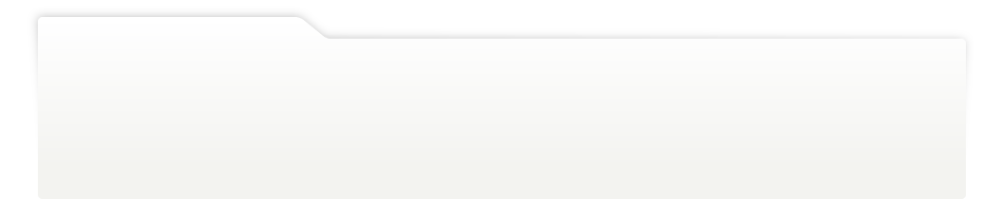
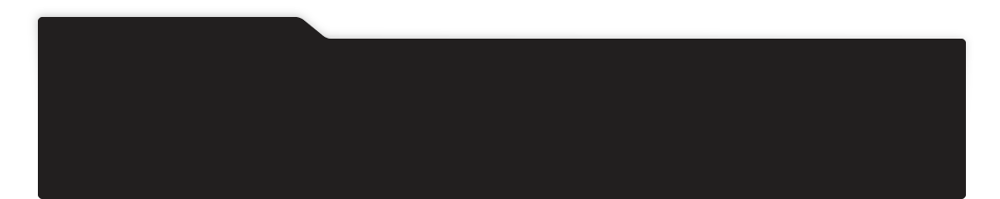
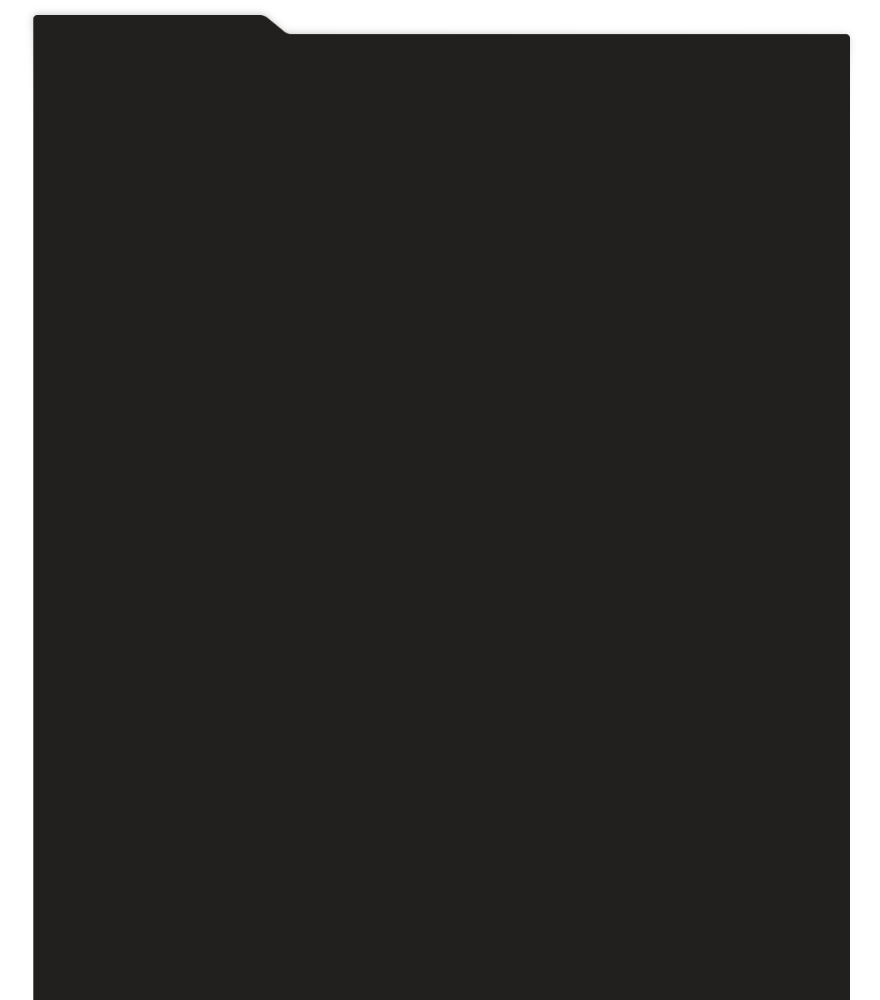
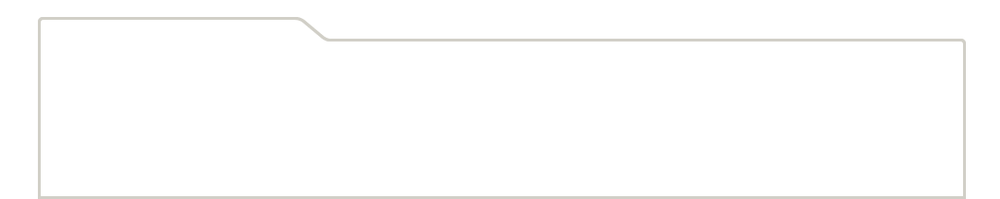
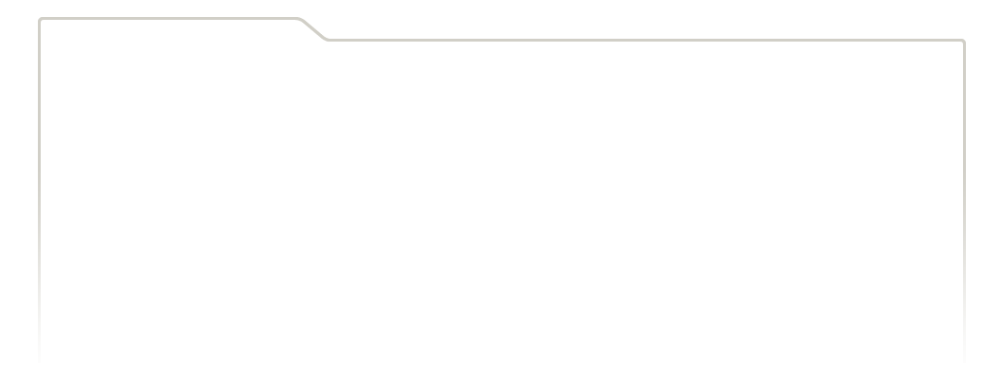
...
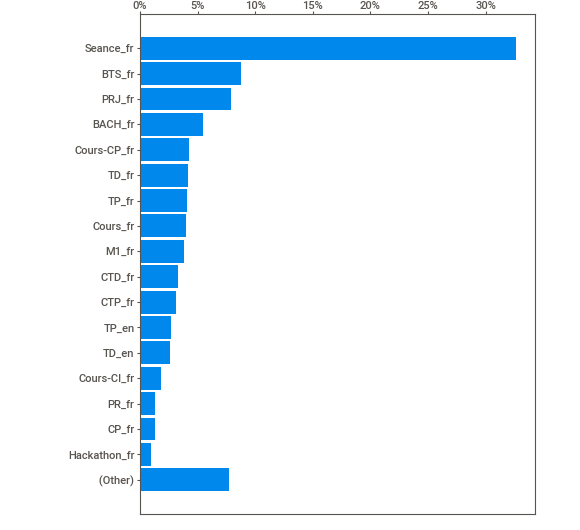
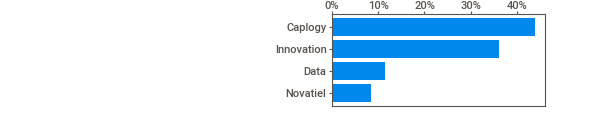
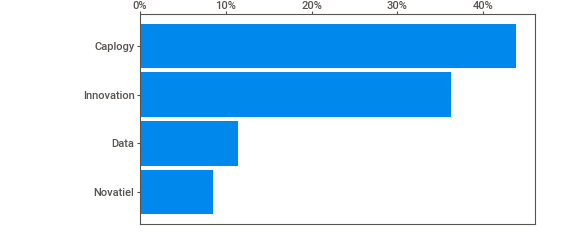
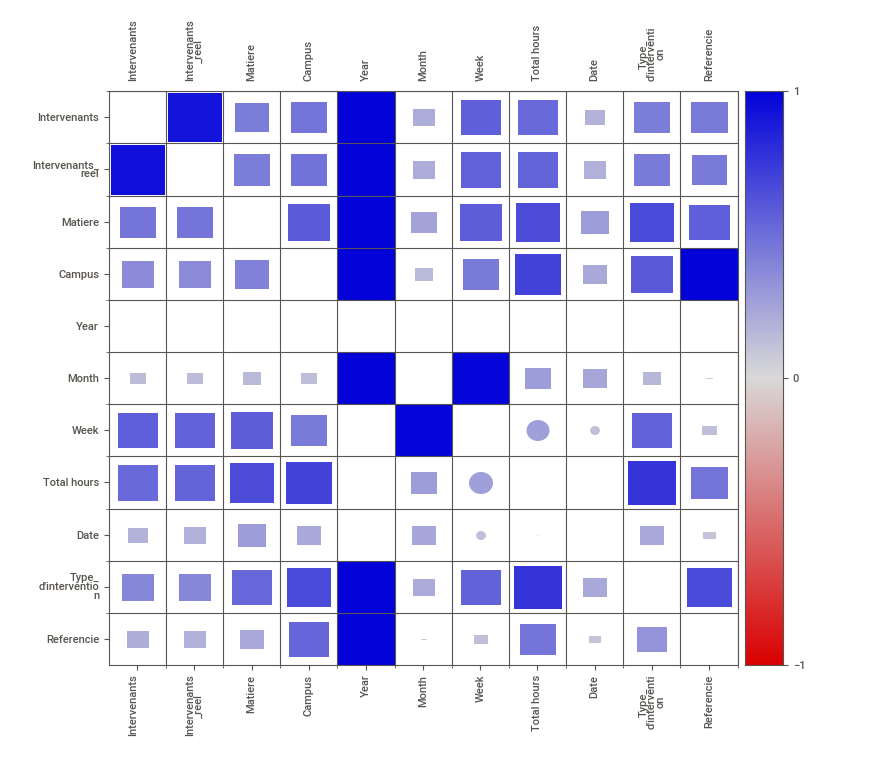
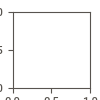

In [ ]:
analyze_report.show_notebook()

###**3) Autoviz**

+ **Visualisez automatiquement n'importe quel jeu de données, de n'importe quelle taille avec une seule ligne de code. Vous pouvez maintenant enregistrer automatiquement ces graphiques interactifs sous forme de fichiers HTML avec le "html"paramètre.**

In [ ]:
!pip install autoviz
!pip install nltk

In [ ]:
import nltk
%matplotlib inline
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('omw-1.4')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

Alert! from version 0.1.43, after importing, you must do '%matplotlib inline' to display charts in Jupyter Notebooks.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 does not display plots but saves them in AutoViz_Plots folder in local machine.
Updated: chart_format='bokeh' generates and displays charts in your local Jupyter notebook.
      chart_format='server' generates and displays charts in the browser - one tab for each chart.
      chart_format='html' silently saves charts HTML format - they are also interactive!


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
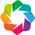

In [ ]:
from autoviz.AutoViz_Class import AutoViz_Class
# create a class
AV = AutoViz_Class()

Shape of your Data Set loaded: (2732, 12)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    12 Predictors classified...
        2 variables removed since they were ID or low-information variables
Number of All Scatter Plots = 10
All Plots done
Time to run AutoViz = 20 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


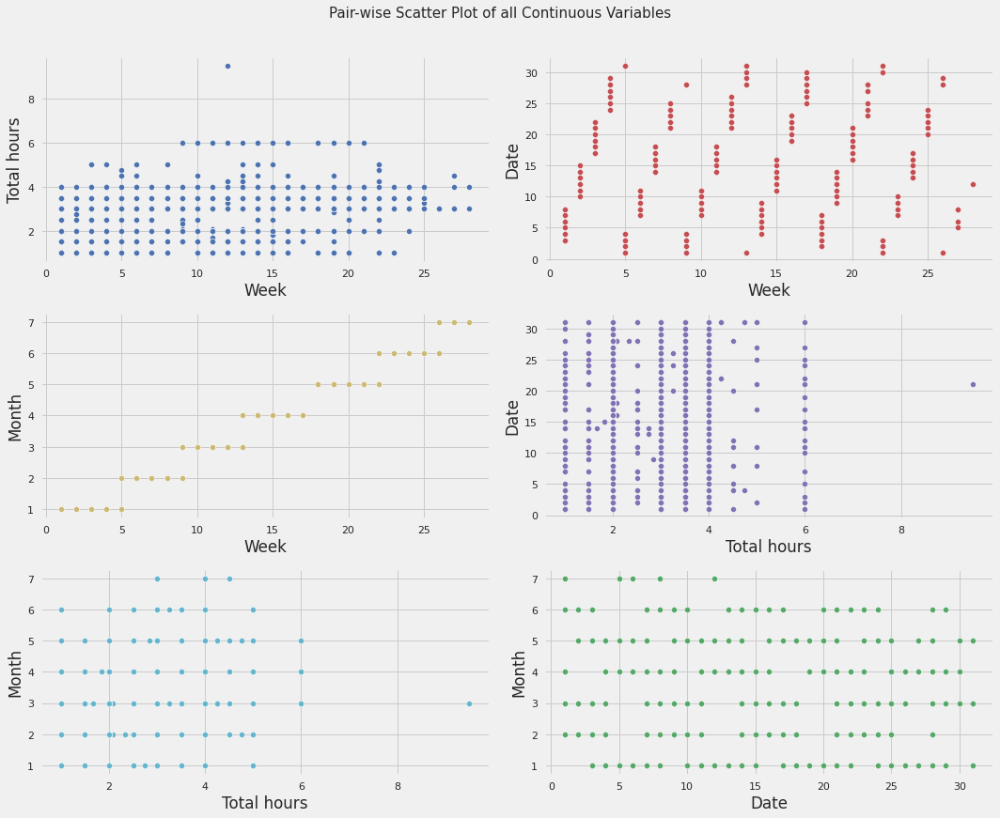

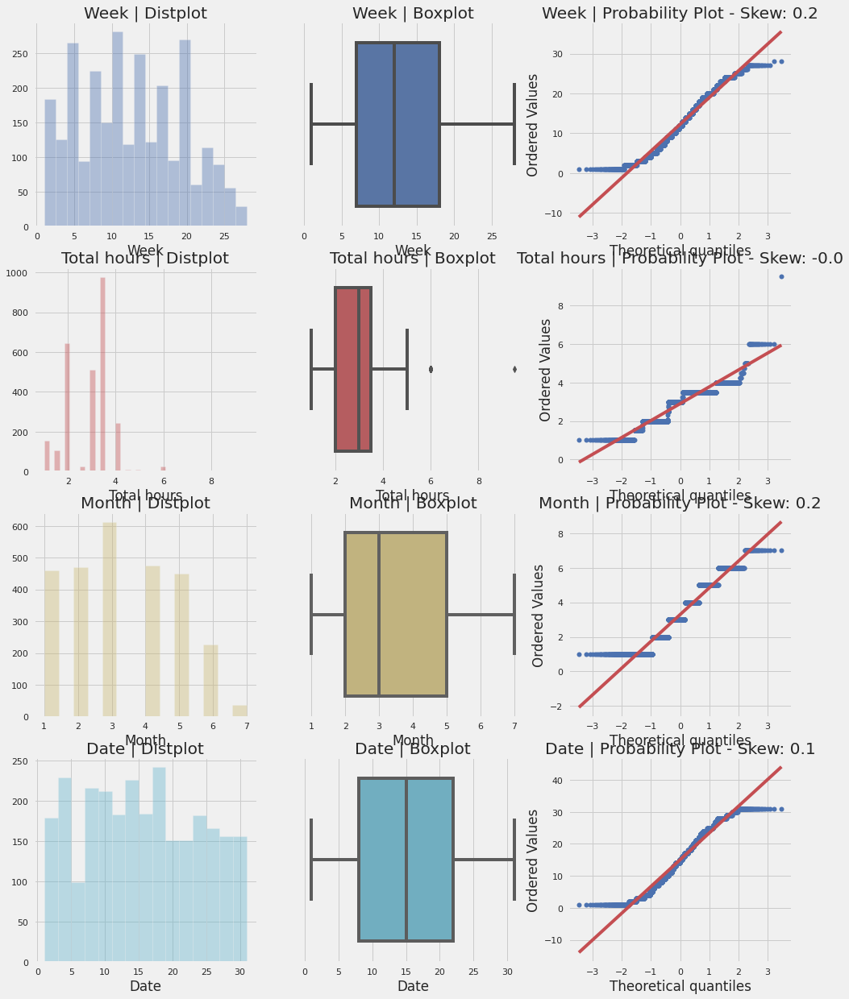

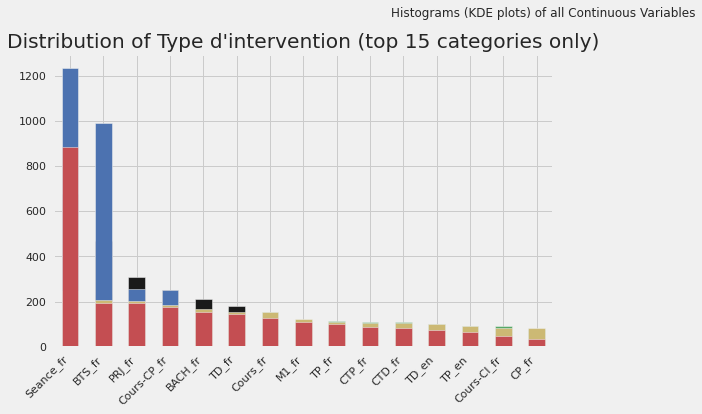

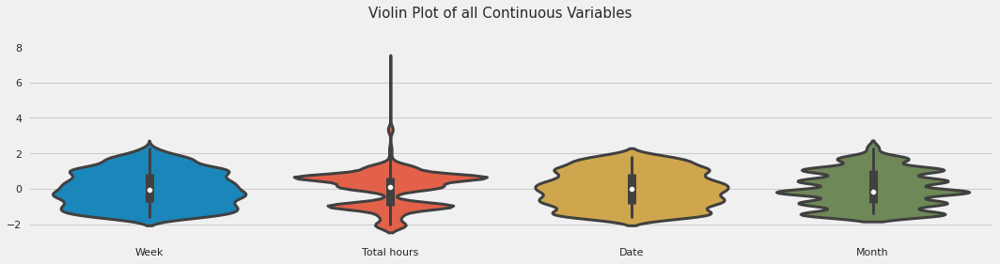

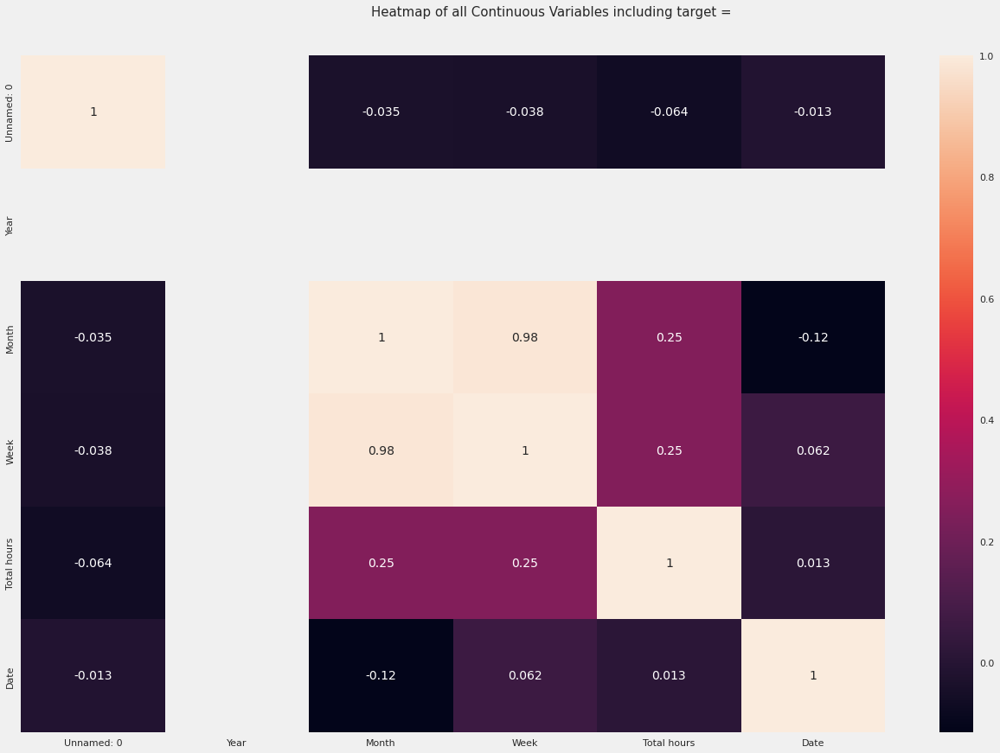

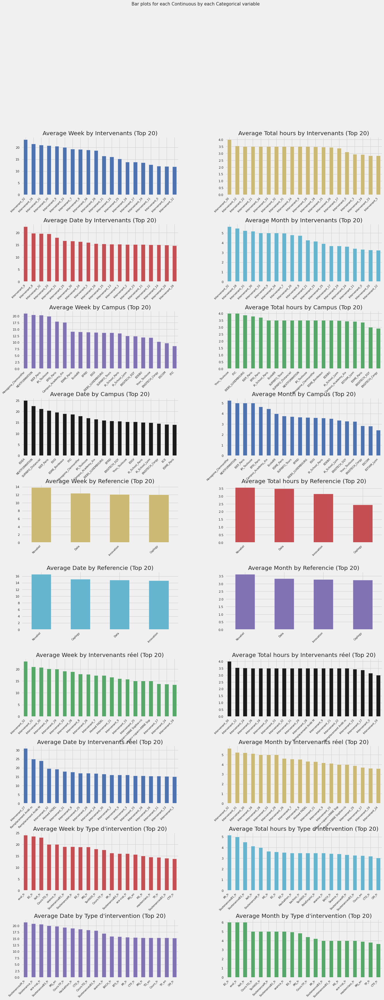

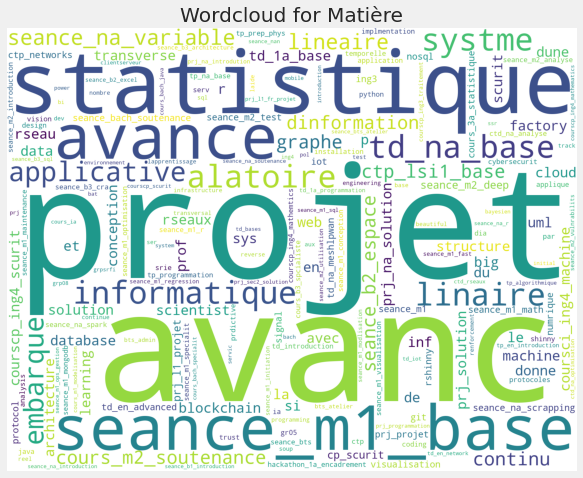

In [ ]:
# upload the data
# read a csv file
filename = "/content/data_cap.csv"
sep = ","
dft = AV.AutoViz(
    filename,
    sep=",",
    depVar="",
    dfte=None,
    header=0,
    verbose=0,
    lowess=False,
    chart_format="svg",
    max_rows_analyzed=150000,
    max_cols_analyzed=193,
)

###**dataprep**

+ **DataPrep permet de préparer vos données à l'aide d'une seule bibliothèque avec quelques lignes de code.**

+ Actuellement, vous pouvez utiliser DataPrep pour :

  + Collecter des données à partir de sources de données communes (via dataprep.connector)
  + Effectuez votre analyse exploratoire des données (via dataprep.eda)
  + Nettoyer et normaliser les données (via dataprep.clean)

###**AED**

+ **DataPrep.EDA est l'outil EDA (Exploratory Data Analysis) le plus rapide et le plus simple en Python**.

+ Il permet de comprendre un Pandas/Dask DataFrame avec quelques lignes de code en quelques secondes.

###**Créez des rapports de profil, rapidement**

+ Vous pouvez créer un beau rapport de profil à partir d'un Pandas/Dask DataFrame avec la create_report fonction.

+ DataPrep.EDA présente les avantages suivants par rapport aux autres outils :

  + **10 fois plus rapide** : DataPrep.EDA peut être 10 fois plus rapide que les outils de profilage basés sur Pandas grâce à son module informatique hautement optimisé basé sur Dask.
  + **Visualisation interactive **: DataPrep.EDA génère des visualisations interactives dans un rapport, ce qui rend le rapport plus attrayant pour les utilisateurs finaux.
  + **Prise en charge du Big Data** : DataPrep.EDA prend naturellement en charge le Big Data stocké dans un cluster Dask en acceptant une trame de données Dask en entrée.



In [ ]:
!pip install -U dataprep

DataPrep Report
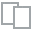
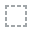
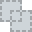
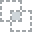
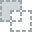
...
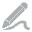
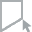
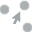
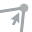
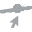

In [ ]:
from dataprep.eda import create_report
create_report(df)

###**data-purifier**

+ **Une bibliothèque Python pour l'analyse exploratoire automatisée des données, le nettoyage automatisé des données et le prétraitement automatisé des données pour les applications d'apprentissage automatique et de traitement du langage naturel en Python.**

In [ ]:
!pip install data-purifier

In [ ]:
import datapurifier as dp
from datapurifier import Mleda,MlReport

print(dp.__version__)

0.3.5


Shape of DataFrame:  (2168, 11)

Sample of Dataframe:


,Intervenants,Intervenants_reel,Matiere,Campus,Year,Month,Week,Total hours,Date,Type_d'intervention,Referencie
1989,Intervenant_16,Intervenant_16,ctp langages et compilation,EFREI,2022.0,2.0,6.0,3.0,7.0,CTD_fr,Caplogy
1682,Intervenant_15,Intervenant_15,prj na solution factory,EFREI,2022.0,6.0,24.0,3.0,14.0,PRJ_fr,Caplogy
368,Intervenant_26,Intervenant_26,seance na integral,IA_School_Paris,2022.0,5.0,20.0,3.5,17.0,Seance_fr,Innovation
1776,Intervenant_3,Intervenant_3,bts atelier de prof,ENSITECH_Cergy,2022.0,2.0,6.0,1.5,7.0,BTS_fr,Innovation
572,Intervenant_3,Intervenant_3,seance b2 denombrement,IA_School_Paris,2022.0,3.0,12.0,3.5,22.0,Seance_fr,Innovation
1204,Intervenant_14,Intervenant_14,td na mesh&lpwan,ESILV,2022.0,2.0,7.0,3.0,16.0,TD_fr,Caplogy
631,Intervenant_0,Intervenant_0,prj na solution factory,EFREI,2022.0,7.0,26.0,3.0,1.0,PRJ_fr,Caplogy
2107,Intervenant_4,Intervenant_8,ing3 traitement du signal numérique,ECE,2022.0,4.0,16.0,1.0,22.0,Cours-TP_fr,Caplogy
282,Intervenant_4,Intervenant_4,cours b2 économie générale,IA_School_Paris,2022.0,2.0,5.0,3.5,4.0,Cours_fr,Innovation
2105,Intervenant_4,Intervenant_4,int2 en introduction to databases,ESME_Paris,2022.0,4.0,14.0,2.0,8.0,BACH_fr,Caplogy



There are total 6 categorical and 5 numerical columns

Description of Data:



,Year,Month,Week,Total hours,Date
count,2168.0,2168.000000,2168.000000,2168.000000,2168.000000
mean,2022.0,3.333487,12.437269,2.976707,15.042435
std,0.0,1.591667,6.799979,0.905151,8.573311
min,2022.0,1.000000,1.000000,1.000000,1.000000
25%,2022.0,2.000000,7.000000,2.000000,8.000000
50%,2022.0,3.000000,12.000000,3.000000,15.000000
75%,2022.0,5.000000,18.000000,3.500000,22.000000
max,2022.0,7.000000,28.000000,9.500000,31.000000


Information regarding data: 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2168 entries, 0 to 2167
Data columns (total 11 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Intervenants         2168 non-null   object 
 1   Intervenants_reel    2168 non-null   object 
 2   Matiere              2168 non-null   object 
 3   Campus               2168 non-null   object 
 4   Year                 2168 non-null   float64
 5   Month                2168 non-null   float64
 6   Week                 2168 non-null   float64
 7   Total hours          2168 non-null   float64
 8   Date                 2168 non-null   float64
 9   Type_d'intervention  2168 non-null   object 
 10  Referencie           2168 non-null   object 
dtypes: float64(5), object(6)
memory usage: 186.4+ KB


None


Congrats!!, The Dataframe has NO NULL VALUES


Interactive Value Count Plot:



Output()


Joint Plot:



Output()


Correlation Heatmap Plot:

Pair Plot:



Output()


Pie Plot:



interactive(children=(Dropdown(description='Columns:', options=('Intervenants', 'Intervenants_reel', 'Matiere'…

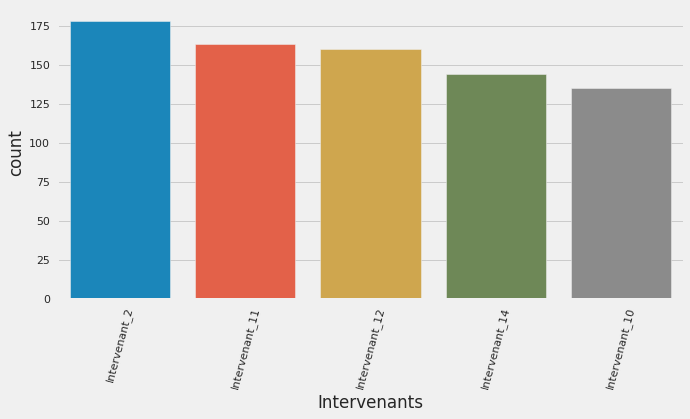

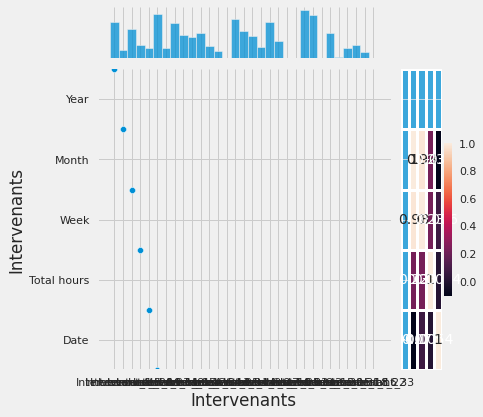

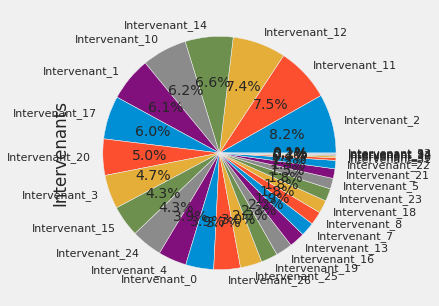

In [ ]:
ae = Mleda(df)
ae

###**Dora**

+ Dora est une bibliothèque Python conçue pour automatiser les parties douloureuses de l'analyse exploratoire des données.

+ La bibliothèque contient des fonctions pratiques pour le nettoyage des données, la sélection et l'extraction des fonctionnalités, la visualisation, le partitionnement des données pour la validation du modèle et les transformations de version des données.

+ La bibliothèque utilise et est destinée à être un complément utile aux outils d'analyse de données Python courants tels que pandas, scikit-learn et matplotlib.

In [ ]:
!pip install Dora

In [ ]:
from Dora import Dora

In [ ]:
dora = Dora()

In [ ]:
dora = Dora(output = "Matiere	", data = df)
dora.data

,Intervenants,Intervenants_reel,Matiere,Campus,Year,Month,Week,Total hours,Date,Type_d'intervention,Referencie
0,Intervenant_1,Intervenant_1,cours b2 économie générale,IA_School_Paris,2022.0,2.0,5.0,3.5,3.0,Cours_fr,Innovation
1,Intervenant_5,Intervenant_5,ctp langages et compilation,EFREI,2022.0,2.0,5.0,3.0,1.0,CTP_fr,Caplogy
2,Intervenant_5,Intervenant_5,prj l1 projet transverse,EFREI,2022.0,2.0,5.0,2.0,1.0,PRJ_fr,Caplogy
3,Intervenant_5,Intervenant_5,ctp en operating systems,EFREI,2022.0,2.0,5.0,2.0,1.0,CTP_en,Caplogy
4,Intervenant_5,Intervenant_5,td en advanced machine learning,ESILV,2022.0,2.0,5.0,3.0,2.0,TD_en,Caplogy
...,...,...,...,...,...,...,...,...,...,...,...
2163,Intervenant_0,Intervenant_0,bts reseau,ENSITECH_Cergy,2022.0,5.0,22.0,4.0,31.0,BTS_fr,Innovation
2164,Intervenant_0,Intervenant_0,bts reseau,ENSITECH_Cergy,2022.0,6.0,22.0,4.0,1.0,BTS_fr,Innovation
2165,Intervenant_0,Intervenant_0,bts reseau,ENSITECH_Cergy,2022.0,6.0,22.0,4.0,2.0,BTS_fr,Innovation
2166,Intervenant_33,Intervenant_33,cours b2 économie générale,ENSITECH_Cergy,2022.0,5.0,20.0,3.5,19.0,BACH_fr,Innovation


###**pandas_summary**

In [ ]:
!pip install datatile

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from datatile.summary.df import DataFrameSummary

dfs = DataFrameSummary(df)

In [ ]:
dfs

In [ ]:
dfs.columns_types

categorical    6
numeric        4
constant       1
Name: types, dtype: int64

In [ ]:
dfs.columns_stats

,Intervenants,Intervenants_reel,Matiere,Campus,Year,Month,Week,Total hours,Date,Type_d'intervention,Referencie
counts,2168,2168,2168,2168,2168,2168,2168,2168,2168,2168,2168
uniques,31,38,75,27,1,7,28,20,31,43,4
missing,0,0,0,0,0,0,0,0,0,0,0
missing_perc,0%,0%,0%,0%,0%,0%,0%,0%,0%,0%,0%
types,categorical,categorical,categorical,categorical,constant,numeric,numeric,numeric,numeric,categorical,categorical


In [ ]:
# we can also access the column using numbers A[1]
dfs['Matiere']

top             seance b2 denombrement: 360
counts                                 2168
uniques                                  75
missing                                   0
missing_perc                             0%
types                           categorical
Name: Matiere, dtype: object

###**KLib**

+ klib est une bibliothèque Python pour l'importation, le nettoyage, l'analyse et le prétraitement des données.


In [ ]:
!pip install -U klib

###**klib.describe ✈- fonctions de visualisation des ensembles de données**
+  **klib.cat_plot(df):** renvoie une visualisation du nombre et de la fréquence des caractéristiques catégorielles.
+ **klib.corr_mat(df):**  renvoie une matrice de corrélation codée en couleur
+ **klib.corr_plot(df):**  renvoie une carte thermique codée en couleur, idéale pour les corrélations.
+ **klib.dist_plot(df):** renvoie un graphique de distribution pour chaque caractéristique numérique
+ **klib.missingval_plot(df):** #renvoie une figure contenant des informations sur les valeurs manquantes

###**klib.clean - fonctions pour nettoyer les ensembles de données**
+ **klib.data_cleaning(df):**effectue un nettoyage des données (suppression des doublons et des lignes/cols vides, ajustement des types de données,...)
+ **klib.clean_column_names(df):**nettoie et normalise les noms de colonnes, également appelé dans data_cleaning()

+ **klib.convert_datatypes(df):** convertit les dtypes existants en dtypes plus efficaces, également appelé dans data_cleaning()
+ **klib.drop_missing(df):**  supprime les valeurs manquantes, également appelé dans data_cleaning()
+ **klib.mv_col_handling(df):** supprime les caractéristiques avec un ratio élevé de valeurs manquantes en fonction du contenu informationnel
+ **klib.pool_duplicate_subsets(df):** regroupe les sous-ensembles de colonnes basés sur les doublons avec un minimum de perte d'information.

In [ ]:
import klib

GridSpec(6, 6)

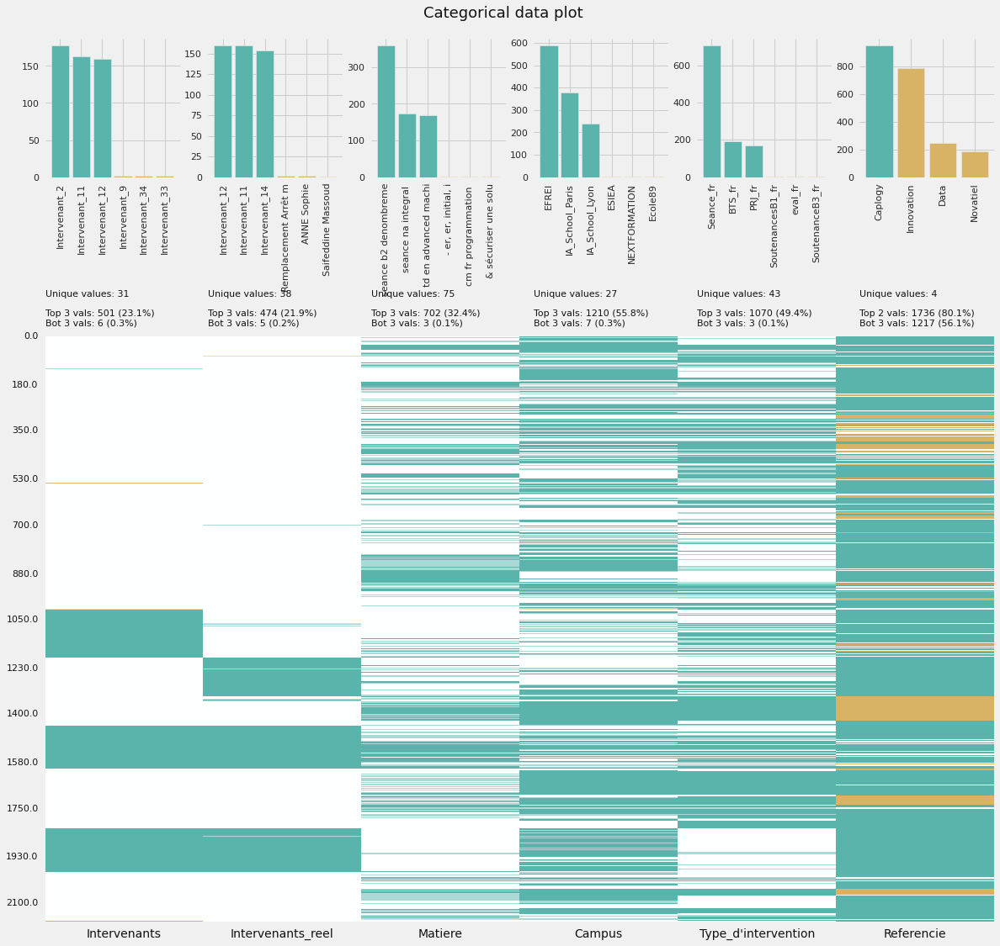

In [ ]:
klib.cat_plot(df)

<AxesSubplot:title={'center':'Feature-correlation (pearson)'}>

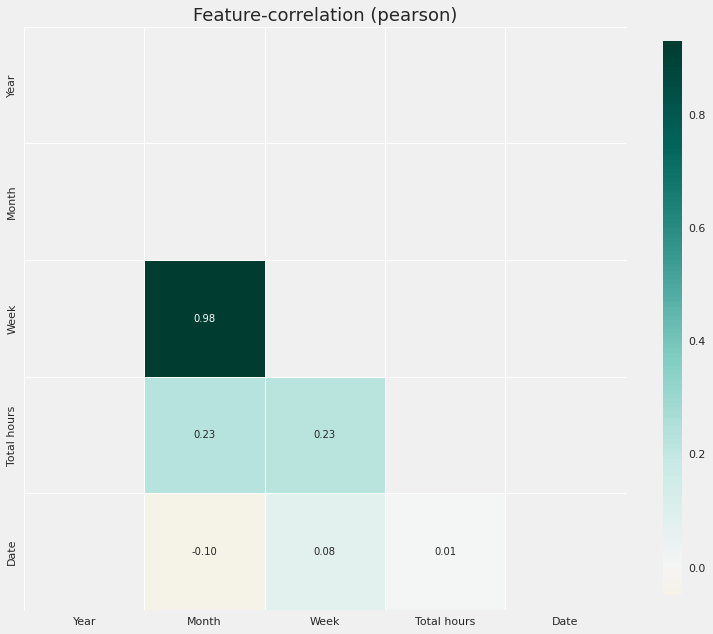

In [ ]:
klib.corr_plot(df)

<AxesSubplot:xlabel='Date', ylabel='Density'>

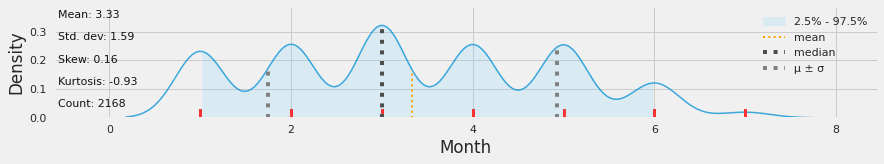

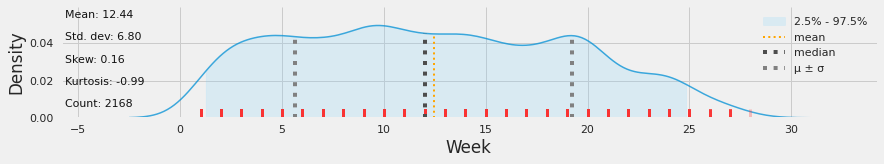

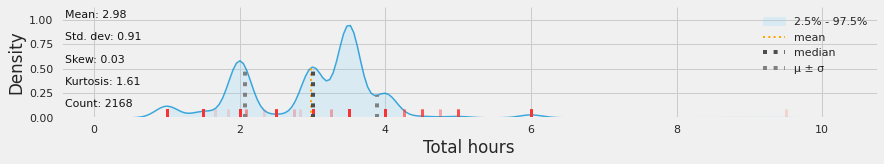

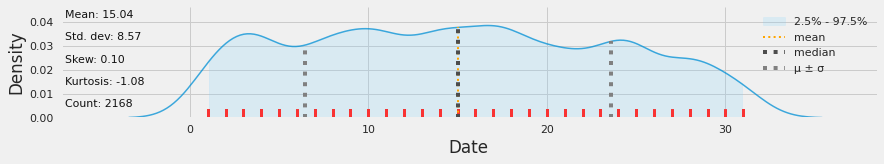

In [ ]:
klib.dist_plot(df)

In [ ]:
klib.missingval_plot(df)

No missing values found in the dataset.


In [ ]:
!pip install nbconvert
!pip install Flask Jinja2

In [ ]:
!jupyter nbconvert  --to pdf /content/Automated_EDA_MEMOIRE.ipynb